In [ ]:
!pip install wfdb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 159.9/159.9 kB 3.2 MB/s eta 0:00:00


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import pandas as pd
import scipy
import pywt
import re
import os
import wfdb
import statsmodels.api as sm
from scipy import signal
from scipy.signal import find_peaks
from scipy.fft import dct
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import LabelEncoder
from scipy.stats import zscore
from scipy.signal import butter, filtfilt, ellip, decimate
from sklearn.ensemble import RandomForestClassifier


# from scipy.stats import skew
# from sklearn.multiclass import OneVsOneClassifier
# from sklearn.model_selection import train_test_split
# from sklearn.metrics import accuracy_score

# import tensorflow as tf
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense
# from tensorflow.keras.utils import to_categorical


In [ ]:
from google.colab import drive
drive.flush_and_unmount()
drive.mount('/content/drive')
!ln -s /content/gdrive/My\ Drive/ /mydrive
!ls /mydrive

Drive not mounted, so nothing to flush and unmount.
Mounted at /content/drive
/mydrive


In [ ]:
record_path = "/content/drive/MyDrive/dataset/patient117/s0291lre"
signal, _ = wfdb.rdsamp(record_path)
signal1 = signal[0:100000, 0]
print(len(signal))
record_path0 = "/content/drive/MyDrive/dataset/patient156/s0299lre"
signal, _ = wfdb.rdsamp(record_path)
signal2 = signal[0:100000, 0]
print(len(signal))
record_path = "/content/drive/MyDrive/dataset/patient173/s0305lre"
signal, _ = wfdb.rdsamp(record_path)
signal3 = signal[0:100000, 0]
print(len(signal))
record_path = "/content/drive/MyDrive/dataset/patient239/s0467_re"
signal, _ = wfdb.rdsamp(record_path)
print(len(signal))
signal4 = signal[0:100000, 0]

signalsArr = [signal1, signal2, signal3, signal4]


115200
115200
115200
120012


In [ ]:
def preprocess_signal(signal, fs, segment_length):
    # Convert the signal to a one-dimensional array if needed
    if signal.ndim > 1:
        signal = signal.ravel()

    # Remove DC component
    signal_dc_removed = signal - np.mean(signal)

    # Define the filter parameters
    lowcut = 0.5  # Lower cut-off frequency
    highcut = 40  # Upper cut-off frequency
    rp = 0.1  # Passband ripple (dB)
    rs = 60  # Stopband attenuation (dB)

    # Normalize the cut-off frequencies
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist

    # Design an elliptic filter with the given parameters
    b, a = ellip(4, rp, rs, [low, high], btype='band')

    # Apply the filter to the signal
    signal_filtered = filtfilt(b, a, signal_dc_removed)

    # Perform downsampling
    target_fs = 1000.0  # Target sampling frequency


    # Perform baseline wander removal using a moving average filter
    window_size = int(0.2 * target_fs)  # Example window size of 200 ms
    signal_smoothed = np.convolve(signal_filtered, np.ones(window_size) / window_size, mode='same')

    # Normalize the signal to have zero mean and unit variance
    signal_normalized = (signal_filtered - np.mean(signal_filtered)) / np.std(signal_filtered)

    # Segment the signal
    num_segments = len(signal_normalized) // segment_length
    segmented_signal = np.array_split(signal_normalized[:num_segments * segment_length], num_segments)


     #Return the segmented signal
    return segmented_signal

In [ ]:
segmented_signals = []
for i in range(0, 4):
  segmented_signals.append(preprocess_signal(signalsArr[i], 1000, 1000))
print(len(segmented_signals[0]))

100


In [ ]:

def detect_t_peaks(ecg_signal, r_peaks, sampling_rate):
    t_peaks = []
    final_peaks = []
    search_window_duration = int(0.4 * sampling_rate)
    wing_width = int(0.05 * sampling_rate)

    for r_peak in r_peaks:
        search_window_start = r_peak + int(0.04 * sampling_rate)

        if search_window_start >= len(ecg_signal):
            break

        search_window_end = search_window_start + search_window_duration
        search_window = ecg_signal[search_window_start:search_window_end]

        t_peaks.clear()

        for i in range(len(search_window)):
            if i >= wing_width and i < len(search_window) - wing_width:
                w1 = search_window[i-wing_width:i]
                w2 = search_window[i:i+wing_width]
                wings_diff = np.sum(w2) - np.sum(w1)
                if wings_diff < 0:  # Negative wing peak detected
                    t_peak_index = search_window_start + i
                    t_peaks.append(t_peak_index)

        if len(t_peaks) > 0:
            final_peaks.append(np.min(t_peaks))

    return final_peaks

def detect_q_s_peaks(ecg_signal, r_peaks):
    q_peaks = []
    s_peaks = []

    for r_peak in r_peaks:

        q_peak = np.argmin(ecg_signal[max(0, r_peak - 50):r_peak]) + max(0, r_peak - 50)
        q_peaks.append(q_peak)

        if r_peak > 0 :
            s_peak = np.argmin(ecg_signal[r_peak:min(r_peak + 100, len(ecg_signal))]) + r_peak
            s_peaks.append(s_peak)

    return q_peaks, s_peaks



def detect_Tonset_Toffset(ecg_signal, r_peaks):
    q_peaks = []
    s_peaks = []

    for r_peak in r_peaks:

        q_peak = np.argmin(ecg_signal[max(0, r_peak - 50):r_peak]) + max(0, r_peak - 100)
        q_peaks.append(q_peak)
        s_peak = np.argmin(ecg_signal[r_peak:min(r_peak + 90, len(ecg_signal))]) + r_peak
        s_peaks.append(s_peak)

    return q_peaks, s_peaks


def detect_qrs_onset_offset(ecg_signal, q_peaks, s_peaks):
    qrs_onsets = []
    qrs_offsets = []

    for q_peak, s_peak in zip(q_peaks, s_peaks):
        qrs_onset = 0
        qrs_offset = len(ecg_signal) - 1

        # Detect QRS onset (backward search from Q peak)
        for i in range(q_peak, 0, -1):
            if ecg_signal[i] > ecg_signal[i-1]:
                qrs_onset = i
                break

        # Detect QRS offset (forward search from S peak)
        for i in range(s_peak, len(ecg_signal) - 1):
            if ecg_signal[i] > ecg_signal[i+1]:
                qrs_offset = i
                break

        qrs_onsets.append(qrs_onset)
        qrs_offsets.append(qrs_offset)

    return qrs_onsets, qrs_offsets



def detect_p_peak(ecg_signal, qrs_onsets, sampling_rate):
    p_peaks = []
    search_window_duration = 0.2
    ratio_threshold = 0.5
    duration_threshold = 0.08

    for qrs_onset in qrs_onsets:
        search_window_start = qrs_onset - int(0.2 * sampling_rate)
        search_window_end = search_window_start + int(search_window_duration * sampling_rate)

        search_window = ecg_signal[search_window_start:search_window_end]
        peak_indices, _ = find_peaks(search_window, distance=int(0.5 * sampling_rate))


        if len(peak_indices) == 1:
            p_peak = peak_indices[0] + search_window_start
        elif len(peak_indices) == 2:
            peak1 = peak_indices[0] + search_window_start
            peak2 = peak_indices[1] + search_window_start

            amplitude_ratio = ecg_signal[peak1] / ecg_signal[peak2]
            duration = peak2 - peak1

            if amplitude_ratio < ratio_threshold and duration < duration_threshold:
                p_peak = peak2
            else:
                p_peak = peak1
        else:
            p_peak = -1

        p_peaks.append(p_peak)

    return p_peaks


In [ ]:
def extract_fiducial_features(ecg_signal, sampling_rate):

    r_peaks, _ = find_peaks(ecg_signal, distance=int(0.5 * sampling_rate))

    t_peaks = detect_t_peaks(ecg_signal, r_peaks, sampling_rate)
    q_peaks, s_peaks = detect_q_s_peaks(ecg_signal, r_peaks)

    qrs_onsets, qrs_offsets = detect_qrs_onset_offset(ecg_signal, q_peaks, s_peaks)
    p_peaks =detect_p_peak(ecg_signal, qrs_onsets, sampling_rate)
    Ponset, Poffset = detect_q_s_peaks(ecg_signal, p_peaks)
    Tonset, Toffset = detect_Tonset_Toffset(ecg_signal, t_peaks)


    # Visualize the ECG signal with R-peaks and T-peaks marked
    plt.plot(ecg_signal)
    plt.plot(r_peaks, ecg_signal[r_peaks],'bo',color='green',label='R-peaks')
    plt.plot(q_peaks, ecg_signal[q_peaks],'bo',color='green',label='Q-peaks')
    plt.plot(s_peaks, ecg_signal[s_peaks],'bo',color='green',label='S-peaks')
    plt.plot(qrs_onsets, ecg_signal[qrs_onsets],'bo',color='g',label='QRSon')
    plt.plot(qrs_offsets, ecg_signal[qrs_offsets],'bo',color='g',label='QRSoff')
    plt.plot(p_peaks, ecg_signal[p_peaks],'bo', c='r', label='P-peaks')
    plt.plot(Ponset, ecg_signal[Ponset],'bo',color='r',label='Ponset')
    plt.plot(Poffset, ecg_signal[Poffset],'bo',color='r',label='Poffset')
    plt.plot(t_peaks, ecg_signal[t_peaks], 'bo', c='b', label='T-peaks')
    plt.plot(Tonset, ecg_signal[Tonset],'bo',color='b',label='Tonset')
    plt.plot(Toffset, ecg_signal[Toffset],'bo',color='b',label='Toffset')

    plt.xlabel('Time')
    plt.ylabel('Amplitude')
    plt.title('ECG Signal with R-peaks and T-peaks')
    plt.legend()
    plt.grid(True)
    plt.show()

    return r_peaks, q_peaks, s_peaks, qrs_onsets, qrs_offsets, p_peaks, Ponset, Poffset, t_peaks, Tonset, Toffset

<ipython-input-102-ad6c071f4209>:16: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(r_peaks, ecg_signal[r_peaks],'bo',color='green',label='R-peaks')
<ipython-input-102-ad6c071f4209>:17: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(q_peaks, ecg_signal[q_peaks],'bo',color='green',label='Q-peaks')
<ipython-input-102-ad6c071f4209>:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(s_peaks, ecg_signal[s_peaks],'bo',color='green',label='S-peaks')
<ipython-input-102-ad6c071f4209>:19: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take preceden

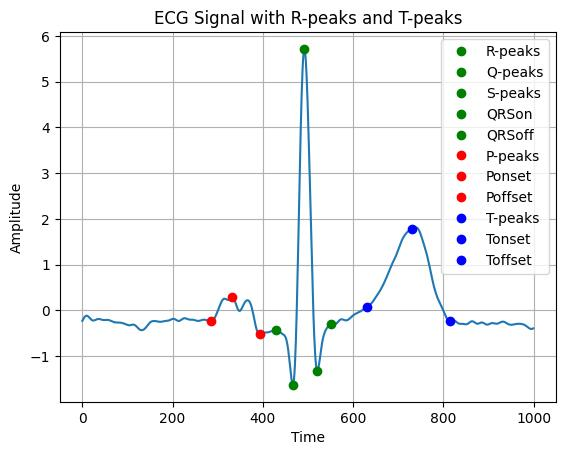

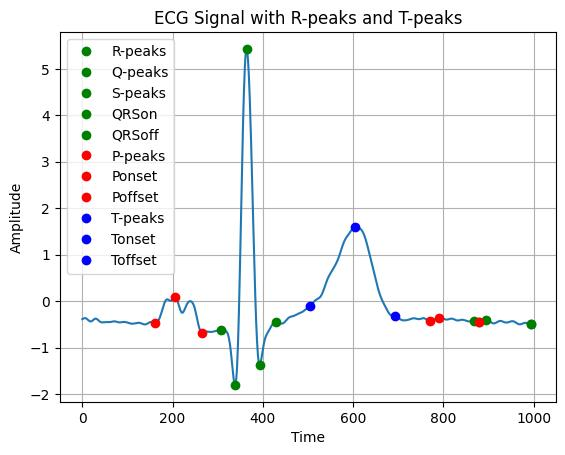

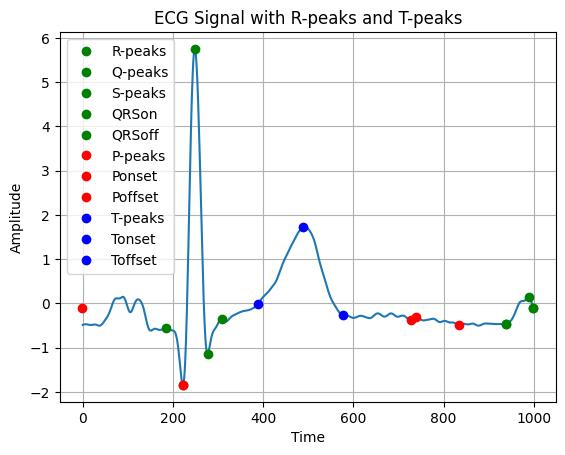

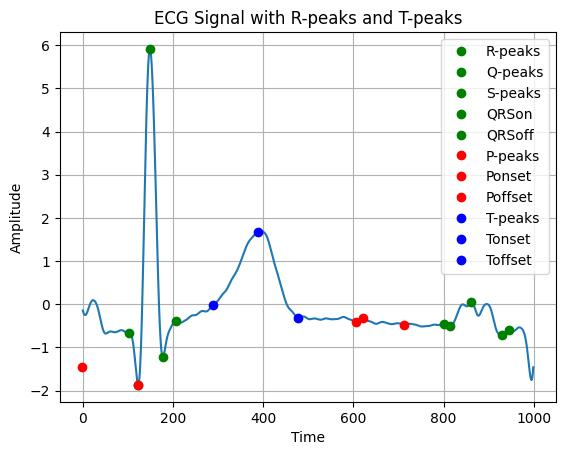

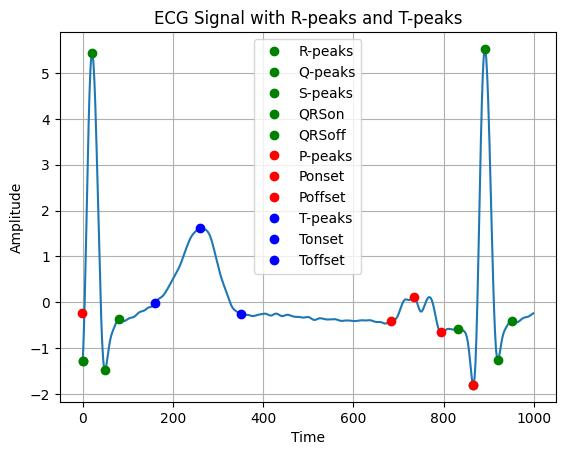

...

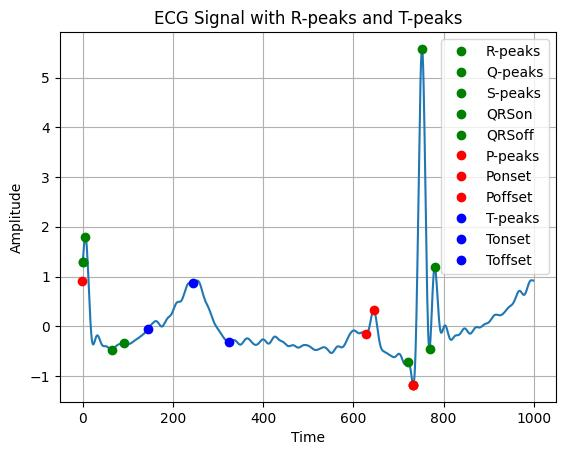

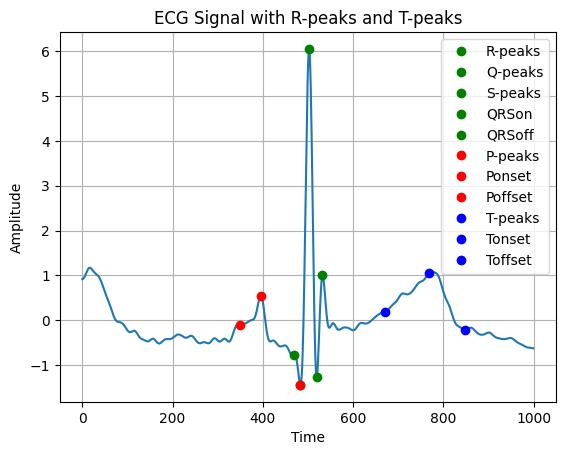

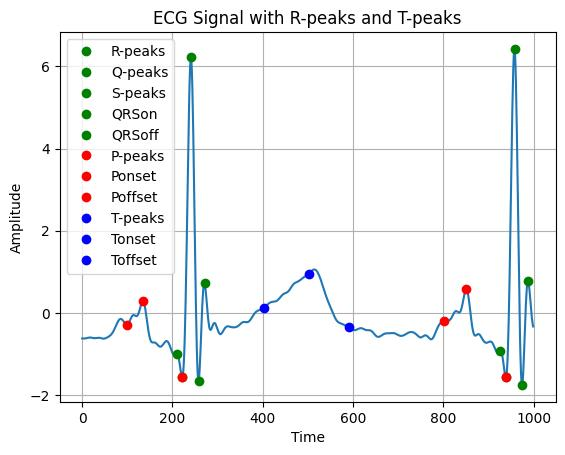

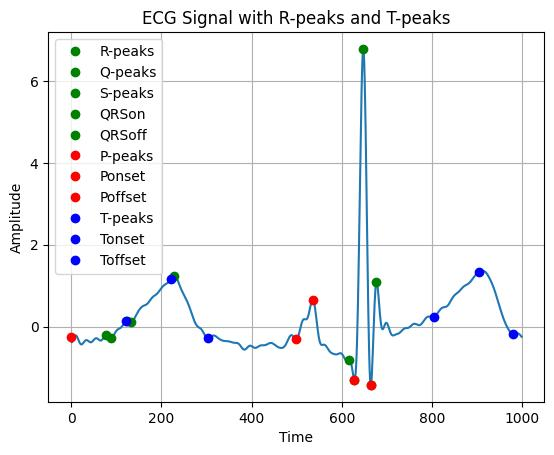

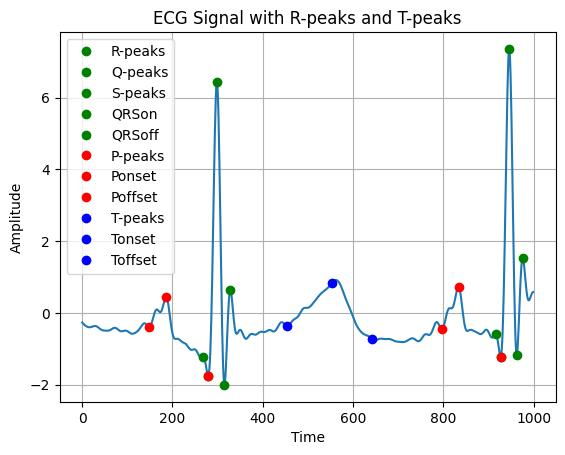

In [ ]:
# Y = []
# X = []  # Features
features_dict = {
    'R Peaks': [],
    'Q Peaks': [],
    'S Peaks': [],
    'QRS Onsets': [],
    'QRS Offsets': [],
    'P Peaks': [],
    'P Onset': [],
    'P Offset': [],
    'T Peaks': [],
    'T Onset': [],
    'T Offset': [],
    'Labels': []
}

for j in range(0, 4):
    for i in range(0, 100):
        # Extract fiducial features
        r_peaks, q_peaks, s_peaks, qrs_onsets, qrs_offsets, p_peaks, Ponset, Poffset, t_peaks, Tonset, Toffset = extract_fiducial_features(segmented_signals[j][i], 1000)
        # Append the features to the dictionary
        features_dict['R Peaks'].append(r_peaks)
        features_dict['Q Peaks'].append(q_peaks)
        features_dict['S Peaks'].append(s_peaks)
        features_dict['QRS Onsets'].append(qrs_onsets)
        features_dict['QRS Offsets'].append(qrs_offsets)
        features_dict['P Peaks'].append(p_peaks)
        features_dict['P Onset'].append(Ponset)
        features_dict['P Offset'].append(Poffset)
        features_dict['T Peaks'].append(t_peaks)
        features_dict['T Onset'].append(Tonset)
        features_dict['T Offset'].append(Toffset)
        features_dict['Labels'].append("person" + str(j + 1))

df = pd.DataFrame(features_dict)



In [ ]:
print(df.head())
# Assuming you have a DataFrame called 'df'
df.to_csv('output.csv', index=False)
print(df.columns)

      R Peaks     Q Peaks     S Peaks  QRS Onsets QRS Offsets     P Peaks  \
0       [492]       [466]       [521]       [428]       [552]       [332]   
1  [364, 894]  [338, 878]  [393, 993]  [308, 867]  [429, 993]  [206, 791]   
2  [248, 989]  [222, 939]  [277, 999]  [184, 939]  [308, 999]   [-1, 740]   
3  [149, 862]  [123, 814]  [178, 929]  [103, 800]  [206, 945]   [-1, 621]   
4   [21, 892]    [0, 866]   [49, 921]    [0, 833]   [81, 951]   [-1, 734]   

      P Onset    P Offset T Peaks T Onset T Offset   Labels  
0       [284]       [393]   [730]   [630]    [814]  person1  
1  [162, 771]  [266, 878]   [604]   [504]    [693]  person1  
2  [222, 727]       [835]   [489]   [389]    [578]  person1  
3  [123, 607]       [712]   [389]   [289]    [478]  person1  
4  [866, 684]       [795]   [261]   [161]    [350]  person1  
Index(['R Peaks', 'Q Peaks', 'S Peaks', 'QRS Onsets', 'QRS Offsets', 'P Peaks',
       'P Onset', 'P Offset', 'T Peaks', 'T Onset', 'T Offset', 'Labels'],
      dtyp

In [ ]:
df.head(5)


,R Peaks,Q Peaks,S Peaks,QRS Onsets,QRS Offsets,P Peaks,P Onset,P Offset,T Peaks,T Onset,T Offset,Labels
0,[492],[466],[521],[428],[552],[332],[284],[393],[730],[630],[814],person1
1,"[364, 894]","[338, 878]","[393, 993]","[308, 867]","[429, 993]","[206, 791]","[162, 771]","[266, 878]",[604],[504],[693],person1
2,"[248, 989]","[222, 939]","[277, 999]","[184, 939]","[308, 999]","[-1, 740]","[222, 727]",[835],[489],[389],[578],person1
3,"[149, 862]","[123, 814]","[178, 929]","[103, 800]","[206, 945]","[-1, 621]","[123, 607]",[712],[389],[289],[478],person1
4,"[21, 892]","[0, 866]","[49, 921]","[0, 833]","[81, 951]","[-1, 734]","[866, 684]",[795],[261],[161],[350],person1


In [ ]:

for col in df.columns[:-1]:  # Exclude the last column (Labels)
    df[col] = df[col].apply(lambda x: np.mean(x))  # Example: Use maximum value as the feature

In [ ]:
df.head(20)

,R Peaks,Q Peaks,S Peaks,QRS Onsets,QRS Offsets,P Peaks,P Onset,P Offset,T Peaks,T Onset,T Offset,Labels
0,492.0,466.0,521.0,428.0,552.0,332.0,284.0,393.0,730.0,630.0,814.0,person1
1,629.0,608.0,693.0,587.5,711.0,498.5,466.5,572.0,604.0,504.0,693.0,person1
2,618.5,580.5,638.0,561.5,653.5,369.5,474.5,835.0,489.0,389.0,578.0,person1
3,505.5,468.5,553.5,451.5,575.5,310.0,365.0,712.0,389.0,289.0,478.0,person1
4,456.5,433.0,485.0,416.5,516.0,366.5,775.0,795.0,261.0,161.0,350.0,person1
5,461.5,423.5,525.5,406.5,542.0,330.5,701.5,760.0,227.0,173.0,280.0,person1
6,355.5,328.0,410.5,317.5,431.5,260.5,564.0,584.0,521.0,441.5,575.0,person1
7,306.0,287.0,368.0,260.0,390.0,204.0,450.5,469.0,471.0,387.5,556.0,person1
8,695.5,677.0,736.0,648.0,752.0,568.5,527.0,655.5,684.0,584.0,773.0,person1
9,601.5,581.5,631.5,557.5,654.0,457.0,419.0,533.0,579.0,479.0,668.0,person1


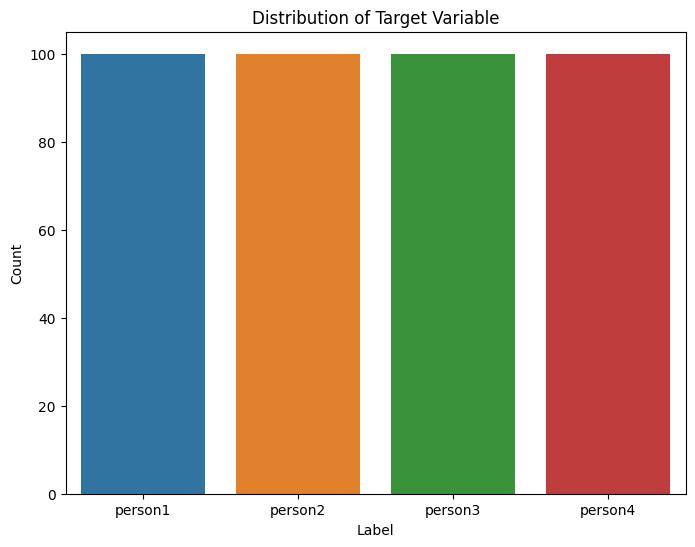

In [ ]:
# Check the distribution of the target variable
plt.figure(figsize=(8, 6))
sns.countplot(x='Labels', data=df)
plt.title('Distribution of Target Variable')
plt.xlabel('Label')
plt.ylabel('Count')
plt.show()

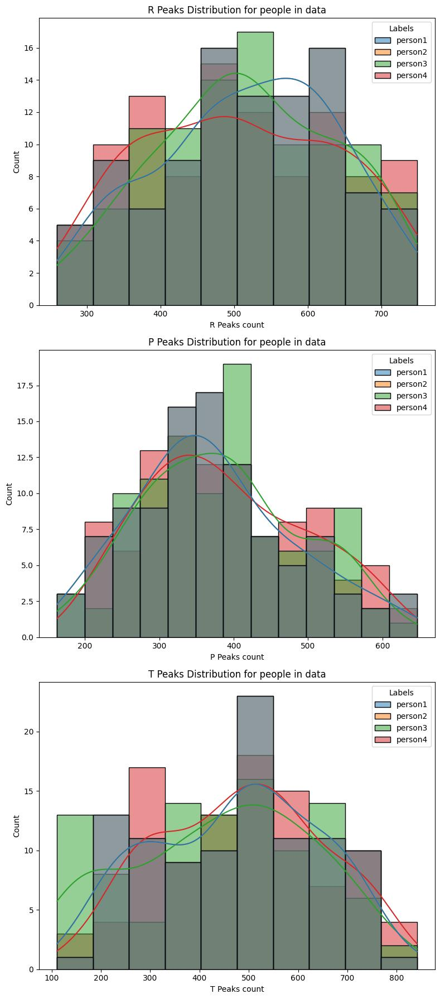

In [ ]:
# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 18))

# Iterate over the columns
columns = ['R Peaks', 'P Peaks', 'T Peaks']  # Modify this list to include the desired columns
for i, col in enumerate(columns):
    # Plot the histogram
    sns.histplot(data=df, x=col, hue='Labels', kde=True, ax=axs[i])
    axs[i].set_title(f'{col} Distribution for people in data')
    axs[i].set_xlabel(f'{col} count')
    axs[i].set_ylabel('Count')

# Adjust spacing between subplots
plt.tight_layout()

# Display the plot
plt.show()

In [ ]:
!pip install dataprep

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


DataPrep Report
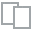
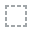
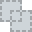
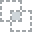
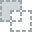
...
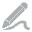
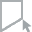
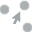
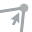
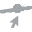

In [ ]:
from dataprep.eda import create_report
report = create_report(df)
report

In [ ]:
# Separate the features and labels
X = df.iloc[:, :-1]  # Features (all columns except the last one)
y = df.iloc[:, -1]   # Labels (last column)

In [ ]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(np.array(X), y, test_size=0.1, random_state=40, shuffle = True)

In [ ]:
from sklearn.preprocessing import LabelEncoder

# Encode labels in y_train
label_encoder = LabelEncoder()
y_train = label_encoder.fit_transform(y_train)

# Encode labels in y_test
y_test = label_encoder.transform(y_test)

In [ ]:
# Train an SVM model
svm_model = SVC(kernel='linear', probability=True)
svm_model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = svm_model.predict(X_test)

# Calculate the accuracy of the model
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.4


In [ ]:
# Print some prediction samples
for i in range(len(y_pred)):
     print("Sample:", X_test[i])
     print("True Label:", y_test[i])
     print("Predicted Label:", y_pred[i])
     print("------------------------------------")

Sample: [2344.85714286 2321.28571429 2375.14285714 2291.85714286 2430.28571429
 2201.71428571 2860.57142857 2644.83333333 2134.5        2034.66666667
 2216.33333333]
True Label: 0
Predicted Label: 0
------------------------------------
Sample: [2669.875      2646.5        2732.75       2622.625      2758.
 2522.625      2702.875      2970.         2506.71428571 2423.14285714
 2554.57142857]
True Label: 2
Predicted Label: 2
------------------------------------
Sample: [2553.14285714 2530.85714286 2632.71428571 2499.28571429 2648.14285714
 2420.42857143 2375.71428571 2501.42857143 2312.16666667 2238.16666667
 2347.33333333]
True Label: 2
Predicted Label: 2
------------------------------------
Sample: [2442.         2416.16666667 2470.83333333 2386.5        2541.16666667
 2268.33333333 2558.33333333 2800.2        2683.33333333 2583.33333333
 2772.33333333]
True Label: 1
Predicted Label: 0
------------------------------------
Sample: [2614.66666667 2588.66666667 2643.16666667 2560.33333333

In [ ]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
lda_classifier = LinearDiscriminantAnalysis()
lda_classifier.fit(X_train, y_train)
y_pred = lda_classifier.predict(X_test)
accuracy = np.mean(y_pred == y_test)
print(f"Accuracy: {accuracy}")

Accuracy: 0.5


In [ ]:
import pickle

with open('svm_model21.pkl', 'wb') as f:
    pickle.dump(svm_model, f)